<a href="https://colab.research.google.com/github/mangare91/Variant-Gene-Drug-Disease-Relation/blob/master/Drug_Discovery_Portfolio_Project_SARS_Google_Colab_Version.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This is a small drug discovery bioinformatics project. We are searching for molecules that could be taken orally by a human to treat CoV-SARS.



In [1]:
pip install chembl_webresource_client

     |████████████████████████████████| 61kB 2.8MB/s 
  Created wheel for chembl-webresource-client: filename=chembl_webresource_client-0.10.2-cp36-none-any.whl size=55662 sha256=519f8c3fabb80ba8ea4cc4eb66475af19e5b1a44c1e56eb1aa1f2635c2fc4912
  Stored in directory: /root/.cache/pip/wheels/e6/96/19/3f042bfda7c669bfe24c8278477f57b0fbbf3e488b4c09e3a8
Successfully built chembl-webresource-client


In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
import sys
import os
sys.path.append('/usr/local/lib/python3.7/site-packages/')  ### This is needed to make sure we can import RDKit in Google Colab.

In [4]:
import pandas as pd
from chembl_webresource_client.new_client import new_client

In [6]:
target = new_client.target
target_query = target.search('SARS-COV')
targets = pd.DataFrame.from_dict(target_query)
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)
targets

,cross_references,organism,pref_name,score,species_group_flag,target_chembl_id,target_components,target_type,tax_id
0,[],Severe acute respiratory syndrome-related coro...,SARS-CoV,32.0,False,CHEMBL4303836,[],ORGANISM,694009
1,[],Severe acute respiratory syndrome coronavirus 2,SARS-CoV-2,28.0,False,CHEMBL4303835,[],ORGANISM,2697049
2,[],SARS coronavirus,SARS coronavirus,15.0,False,CHEMBL612575,[],ORGANISM,227859
3,"[{'xref_id': 'P0C6U8', 'xref_name': None, 'xre...",SARS coronavirus,SARS coronavirus 3C-like proteinase,11.0,False,CHEMBL3927,"[{'accession': 'P0C6U8', 'component_descriptio...",SINGLE PROTEIN,227859
4,"[{'xref_id': 'P0C6X7', 'xref_name': None, 'xre...",SARS coronavirus,Replicase polyprotein 1ab,5.0,False,CHEMBL5118,"[{'accession': 'P0C6X7', 'component_descriptio...",SINGLE PROTEIN,227859


In [7]:
selected_target = targets.target_chembl_id[3]
selected_target

'CHEMBL3927'

In [8]:
activity = new_client.activity
res = activity.filter(target_chembl_id=selected_target)

In [10]:
df = pd.DataFrame.from_dict(res)

In [11]:
df.head(10)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1480934,[],CHEMBL831837,In vitro percent inhibition against SARS coron...,B,BAO_0000201,BAO_0000357,single protein format,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C(N)=O)ccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,None,CHEMBL372889,None,CHEMBL372889,None,False,http://qudt.org/vocab/unit#Percent,384102,=,1,True,=,None,Inhibition,%,None,25.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,Inhibition,%,UO_0000187,None,25.0
1,None,1480935,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '18.28', 'le': '0.33', 'lle': '3.25', ...",CHEMBL187579,None,CHEMBL187579,5.14,False,http://www.openphacts.org/units/Nanomolar,384103,=,1,True,=,None,IC50,nM,None,7200.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,7.2
2,None,1480936,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '12.10', 'le': '0.33', 'lle': '1.22', ...",CHEMBL188487,None,CHEMBL188487,5.03,False,http://www.openphacts.org/units/Nanomolar,383984,=,1,True,=,None,IC50,nM,None,9400.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,9.4
3,None,1481061,[],CHEMBL830868,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '11.56', 'le': '0.29', 'lle': '2.21', ...",CHEMBL185698,None,CHEMBL185698,4.87,False,http://www.openphacts.org/units/Nanomolar,384106,=,1,True,=,None,IC50,nM,None,13500.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,13.5
4,None,1481062,[],CHEMBL832053,In vitro percent inhibition against SARS coron...,B,BAO_0000201,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3o2)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,None,CHEMBL188484,None,CHEMBL188484,None,False,http://qudt.org/vocab/unit#Percent,383987,=,1,True,=,None,Inhibition,%,None,13.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,Inhibition,%,UO_0000187,None,13.0
5,None,1481063,[],CHEMBL831837,In vitro percent inhibition against SARS coron...,B,BAO_0000201,BAO_0000357,single protein format,COc1ccc2c(c1)C(=O)C(=O)N2Cc1cc2ccccc2o1,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,None,CHEMBL362781,None,CHEMBL362781,None,False,http://qudt.org/vocab/unit#Percent,383988,=,1,True,=,None,Inhibition,%,None,13.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,Inhibition,%,UO_0000187,None,13.0
6,None,1481064,[],CHEMBL831837,In vitro percent inhibition against SARS coron...,B,BAO_0000201,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3o2)c2ccc([N+](=O)[O-])cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,None,CHEMBL191322,None,CHEMBL191322,None,False,http://qudt.org/vocab/unit#Percent,384074,=,1,True,=,None,Inhibition,%,None,24.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None

Narrowing down to type IC50

In [12]:
activity2 = new_client.activity
res2 = activity2.filter(target_chembl_id=selected_target).filter(type='IC50')

In [13]:
df2 = pd.DataFrame.from_dict(res2)
df2.head(10)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1480935,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '18.28', 'le': '0.33', 'lle': '3.25', ...",CHEMBL187579,None,CHEMBL187579,5.14,False,http://www.openphacts.org/units/Nanomolar,384103,=,1,True,=,None,IC50,nM,None,7200.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,7.2
1,None,1480936,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '12.10', 'le': '0.33', 'lle': '1.22', ...",CHEMBL188487,None,CHEMBL188487,5.03,False,http://www.openphacts.org/units/Nanomolar,383984,=,1,True,=,None,IC50,nM,None,9400.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,9.4
2,None,1481061,[],CHEMBL830868,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '11.56', 'le': '0.29', 'lle': '2.21', ...",CHEMBL185698,None,CHEMBL185698,4.87,False,http://www.openphacts.org/units/Nanomolar,384106,=,1,True,=,None,IC50,nM,None,13500.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,13.5
3,None,1481065,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '16.64', 'le': '0.32', 'lle': '1.25', ...",CHEMBL426082,None,CHEMBL426082,4.88,False,http://www.openphacts.org/units/Nanomolar,384075,=,1,True,=,None,IC50,nM,None,13110.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,13.11
4,None,1481066,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-],None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '16.84', 'le': '0.32', 'lle': '2.16', ...",CHEMBL187717,None,CHEMBL187717,5.70,False,http://www.openphacts.org/units/Nanomolar,384234,=,1,True,=,None,IC50,nM,None,2000.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,2.0
5,None,1481068,[],CHEMBL828143,In vitro inhibitory concentration SARS coronav...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c(Br)cccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '16.14', 'le': '0.37', 'lle': '1.62', ...",CHEMBL365134,None,CHEMBL365134,6.01,False,http://www.openphacts.org/units/Nanomolar,384081,=,1,True,=,None,IC50,nM,None,980.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,0.98
6,None,1481088,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccc(F)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '17.08', 'le': '0.33', 'lle': '1.55', ...",CHEMBL187598,None,CHE

Let's save a CSV at this point and the reload the new CSV.

In [14]:
df2.to_csv('IMP13_bioactivity_data.csv', index=False)

In [15]:
df3 = df2
### df3 = pd.read_csv(r'C:\Users\PheXeRiaN\Desktop\Drug Discovery\IMP13_bioactivity_data.csv')   ### This is command for when saving csv not in Google Colab to load from CSV.

In [16]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', None)
df3.head(5)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1480935,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '18.28', 'le': '0.33', 'lle': '3.25', ...",CHEMBL187579,None,CHEMBL187579,5.14,False,http://www.openphacts.org/units/Nanomolar,384103,=,1,True,=,None,IC50,nM,None,7200.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,7.2
1,None,1480936,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '12.10', 'le': '0.33', 'lle': '1.22', ...",CHEMBL188487,None,CHEMBL188487,5.03,False,http://www.openphacts.org/units/Nanomolar,383984,=,1,True,=,None,IC50,nM,None,9400.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,9.4
2,None,1481061,[],CHEMBL830868,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '11.56', 'le': '0.29', 'lle': '2.21', ...",CHEMBL185698,None,CHEMBL185698,4.87,False,http://www.openphacts.org/units/Nanomolar,384106,=,1,True,=,None,IC50,nM,None,13500.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,13.5
3,None,1481065,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '16.64', 'le': '0.32', 'lle': '1.25', ...",CHEMBL426082,None,CHEMBL426082,4.88,False,http://www.openphacts.org/units/Nanomolar,384075,=,1,True,=,None,IC50,nM,None,13110.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,13.11
4,None,1481066,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-],None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '16.84', 'le': '0.32', 'lle': '2.16', ...",CHEMBL187717,None,CHEMBL187717,5.70,False,http://www.openphacts.org/units/Nanomolar,384234,=,1,True,=,None,IC50,nM,None,2000.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,2.0


### Dealing with missing data



In [17]:
df4 = df3[df3.value.notna()]
df4.head(5)

,activity_comment,activity_id,activity_properties,assay_chembl_id,assay_description,assay_type,bao_endpoint,bao_format,bao_label,canonical_smiles,data_validity_comment,data_validity_description,document_chembl_id,document_journal,document_year,ligand_efficiency,molecule_chembl_id,molecule_pref_name,parent_molecule_chembl_id,pchembl_value,potential_duplicate,qudt_units,record_id,relation,src_id,standard_flag,standard_relation,standard_text_value,standard_type,standard_units,standard_upper_value,standard_value,target_chembl_id,target_organism,target_pref_name,target_tax_id,text_value,toid,type,units,uo_units,upper_value,value
0,None,1480935,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '18.28', 'le': '0.33', 'lle': '3.25', ...",CHEMBL187579,None,CHEMBL187579,5.14,False,http://www.openphacts.org/units/Nanomolar,384103,=,1,True,=,None,IC50,nM,None,7200.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,7.2
1,None,1480936,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '12.10', 'le': '0.33', 'lle': '1.22', ...",CHEMBL188487,None,CHEMBL188487,5.03,False,http://www.openphacts.org/units/Nanomolar,383984,=,1,True,=,None,IC50,nM,None,9400.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,9.4
2,None,1481061,[],CHEMBL830868,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '11.56', 'le': '0.29', 'lle': '2.21', ...",CHEMBL185698,None,CHEMBL185698,4.87,False,http://www.openphacts.org/units/Nanomolar,384106,=,1,True,=,None,IC50,nM,None,13500.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,13.5
3,None,1481065,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21,None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '16.64', 'le': '0.32', 'lle': '1.25', ...",CHEMBL426082,None,CHEMBL426082,4.88,False,http://www.openphacts.org/units/Nanomolar,384075,=,1,True,=,None,IC50,nM,None,13110.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,13.11
4,None,1481066,[],CHEMBL829584,In vitro inhibitory concentration against SARS...,B,BAO_0000190,BAO_0000357,single protein format,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-],None,None,CHEMBL1139624,Bioorg. Med. Chem. Lett.,2005,"{'bei': '16.84', 'le': '0.32', 'lle': '2.16', ...",CHEMBL187717,None,CHEMBL187717,5.70,False,http://www.openphacts.org/units/Nanomolar,384234,=,1,True,=,None,IC50,nM,None,2000.0,CHEMBL3927,SARS coronavirus,SARS coronavirus 3C-like proteinase,227859,None,None,IC50,uM,UO_0000065,None,2.0


### We need to classify our data in preprocessing to either active, or inactive, or intermediate.  A molecule less than 1000 nanomolar is considered active.

In [18]:
bioactivity_class = []
for x in df4.standard_value:
    if float(x) >= 10000:
        bioactivity_class.append('inactive')
    elif float(x) <= 1000:
        bioactivity_class.append('active')
    else:
        bioactivity_class.append('intermediate')

### Now we need to remove duplicates for a few of the rows and moves features around to a new dataframe.

In [27]:
molecule_chembl_id = []
for x in df4.molecule_chembl_id:
    molecule_chembl_id.append(x)

In [28]:
canonical_smiles = []
for x in df4.canonical_smiles:
    canonical_smiles.append(x)

In [29]:
standard_value = []
for x in df4.standard_value:
    standard_value.append(x)

In [30]:
data_tuples = list(zip(molecule_chembl_id, canonical_smiles, bioactivity_class, standard_value))

In [31]:
df5 = pd.DataFrame(data_tuples, columns=['molecule_chembl_id', 'canonical_smiles', 'bioactivity_class', 'standard_value'])
df5.head(5)

,molecule_chembl_id,canonical_smiles,bioactivity_class,standard_value
0,CHEMBL187579,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,intermediate,7200.0
1,CHEMBL188487,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,intermediate,9400.0
2,CHEMBL185698,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,inactive,13500.0
3,CHEMBL426082,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21,inactive,13110.0
4,CHEMBL187717,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-],intermediate,2000.0


In [32]:
df5.to_csv('bioactivity_preprocessed_data.csv', index=False)

### Calculate Lipinski descriptors.  Rule of Five for ADME pharmacokinetic profile.

In [33]:
! wget https://repo.anaconda.com/miniconda/Miniconda3-py37_4.8.2-Linux-x86_64.sh
! chmod +x Miniconda3-py37_4.8.2-Linux-x86_64.sh
! bash ./Miniconda3-py37_4.8.2-Linux-x86_64.sh -b -f -p /usr/local
! conda install -c rdkit rdkit -y
import sys
sys.path.append('/usr/local/lib/python3.7/site-packages/')

--2020-10-25 11:22:07--  https://repo.anaconda.com/miniconda/Miniconda3-py37_4.8.2-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.131.3, 104.16.130.3, 2606:4700::6810:8303, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.131.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 85055499 (81M) [application/x-sh]
Saving to: ‘Miniconda3-py37_4.8.2-Linux-x86_64.sh.1’

Miniconda3-py37_4.8 100%[===================>]  81.12M   160MB/s    in 0.5s    

2020-10-25 11:22:07 (160 MB/s) - ‘Miniconda3-py37_4.8.2-Linux-x86_64.sh.1’ saved [85055499/85055499]

PREFIX=/usr/local
Unpacking payload ...
Solving environment: / - \ | / - \ | / - \ failed with initial frozen solve. Retrying with flexible solve.
Solving environment: / - \ | / - \ | / - failed with repodata from current_repodata.json, will retry with next repodata source.
Solving environment: - \ | / - \ | / - \ | fail

In [34]:
!wget -c https://repo.continuum.io/miniconda/Miniconda3-py37_4.8.3-Linux-x86_64.sh
!chmod +x Miniconda3-py37_4.8.3-Linux-x86_64.sh
!time bash ./Miniconda3-py37_4.8.3-Linux-x86_64.sh -b -f -p /usr/local
!time conda install -q -y -c conda-forge rdkit

import sys
sys.path.append('/usr/local/lib/python3.7/site-packages/')

--2020-10-25 11:24:42--  https://repo.continuum.io/miniconda/Miniconda3-py37_4.8.3-Linux-x86_64.sh
Resolving repo.continuum.io (repo.continuum.io)... 104.18.200.79, 104.18.201.79, 2606:4700::6812:c84f, ...
Connecting to repo.continuum.io (repo.continuum.io)|104.18.200.79|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://repo.anaconda.com/miniconda/Miniconda3-py37_4.8.3-Linux-x86_64.sh [following]
--2020-10-25 11:24:42--  https://repo.anaconda.com/miniconda/Miniconda3-py37_4.8.3-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.130.3, 104.16.131.3, 2606:4700::6810:8203, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.130.3|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

PREFIX=/usr/local
Unpacking payload ...
Solving environment: \ | / - \ | / - \ done

## Package Plan ##

  envi

In [36]:
import sys
import os
import requests
import subprocess
import shutil
from logging import getLogger, StreamHandler, INFO


logger = getLogger(__name__)
logger.addHandler(StreamHandler())
logger.setLevel(INFO)


def install(
        chunk_size=4096,
        file_name="Miniconda3-latest-Linux-x86_64.sh",
        url_base="https://repo.continuum.io/miniconda/",
        conda_path=os.path.expanduser(os.path.join("~", "miniconda")),
        rdkit_version=None,
        add_python_path=True,
        force=False):
    """install rdkit from miniconda
    ```
    import rdkit_installer
    rdkit_installer.install()
    ```
    """

    python_path = os.path.join(
        conda_path,
        "lib",
        "python{0}.{1}".format(*sys.version_info),
        "site-packages",
    )

    if add_python_path and python_path not in sys.path:
        logger.info("add {} to PYTHONPATH".format(python_path))
        sys.path.append(python_path)

    if os.path.isdir(os.path.join(python_path, "rdkit")):
        logger.info("rdkit is already installed")
        if not force:
            return

        logger.info("force re-install")

    url = url_base + file_name
    python_version = "{0}.{1}.{2}".format(*sys.version_info)

    logger.info("python version: {}".format(python_version))

    if os.path.isdir(conda_path):
        logger.warning("remove current miniconda")
        shutil.rmtree(conda_path)
    elif os.path.isfile(conda_path):
        logger.warning("remove {}".format(conda_path))
        os.remove(conda_path)

    logger.info('fetching installer from {}'.format(url))
    res = requests.get(url, stream=True)
    res.raise_for_status()
    with open(file_name, 'wb') as f:
        for chunk in res.iter_content(chunk_size):
            f.write(chunk)
    logger.info('done')

    logger.info('installing miniconda to {}'.format(conda_path))
    subprocess.check_call(["bash", file_name, "-b", "-p", conda_path])
    logger.info('done')

    logger.info("installing rdkit")
    subprocess.check_call([
        os.path.join(conda_path, "bin", "conda"),
        "install",
        "--yes",
        "-c", "rdkit",
        "python=={}".format(python_version),
        "rdkit" if rdkit_version is None else "rdkit=={}".format(rdkit_version)])
    logger.info("done")

    import rdkit
    logger.info("rdkit-{} installation finished!".format(rdkit.__version__))


if __name__ == "__main__":
    install()

rdkit is already installed
rdkit is already installed


In [37]:
import numpy as np
from rdkit import Chem
from rdkit.Chem import Descriptors, Lipinski

In [38]:
def lipinski(smiles, verbose=False):

    moldata= []
    for elem in smiles:
        mol=Chem.MolFromSmiles(elem) 
        moldata.append(mol)
       
    baseData= np.arange(1,1)
    i=0  
    for mol in moldata:        
       
        desc_MolWt = Descriptors.MolWt(mol)
        desc_MolLogP = Descriptors.MolLogP(mol)
        desc_NumHDonors = Lipinski.NumHDonors(mol)
        desc_NumHAcceptors = Lipinski.NumHAcceptors(mol)
           
        row = np.array([desc_MolWt,
                        desc_MolLogP,
                        desc_NumHDonors,
                        desc_NumHAcceptors])   
    
        if(i==0):
            baseData=row
        else:
            baseData=np.vstack([baseData, row])
        i=i+1      
    
    columnNames=["MW","LogP","NumHDonors","NumHAcceptors"]   
    descriptors = pd.DataFrame(data=baseData,columns=columnNames)
    
    return descriptors

### Made from code from https://codeocean.com/capsule/8848590/tree/v1

In [39]:
df_lipinski = lipinski(df.canonical_smiles)

In [40]:
df_lipinski.head(10)

,MW,LogP,NumHDonors,NumHAcceptors
0,299.286,1.11984,1.0,5.0
1,281.271,1.89262,0.0,5.0
2,415.589,3.81320,0.0,2.0
3,421.190,2.66050,0.0,4.0
4,403.175,3.76690,0.0,3.0
5,307.305,3.17090,0.0,4.0
6,322.276,3.07050,0.0,5.0
7,293.347,3.63080,0.0,3.0
8,338.344,3.53900,0.0,5.0
9,308.362,3.21300,1.0,4.0


### Combining dataframes

In [41]:
df6 = pd.concat([df5, df_lipinski], axis=1)

In [42]:
df6.head(10)

,molecule_chembl_id,canonical_smiles,bioactivity_class,standard_value,MW,LogP,NumHDonors,NumHAcceptors
0,CHEMBL187579,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,intermediate,7200.0,299.286,1.11984,1.0,5.0
1,CHEMBL188487,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,intermediate,9400.0,281.271,1.89262,0.0,5.0
2,CHEMBL185698,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,inactive,13500.0,415.589,3.81320,0.0,2.0
3,CHEMBL426082,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21,inactive,13110.0,421.190,2.66050,0.0,4.0
4,CHEMBL187717,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-],intermediate,2000.0,403.175,3.76690,0.0,3.0
5,CHEMBL365134,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c(Br)cccc21,active,980.0,307.305,3.17090,0.0,4.0
6,CHEMBL187598,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccc(F)cc21,intermediate,4820.0,322.276,3.07050,0.0,5.0
7,CHEMBL190743,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccc(I)cc21,active,950.0,293.347,3.63080,0.0,3.0
8,CHEMBL365469,O=C1C(=O)N(Cc2cc3ccccc3s2)c2cccc(Cl)c21,inactive,11200.0,338.344,3.53900,0.0,5.0
9,CHEMBL188983,O=C1C(=O)N(C/C=C/c2cc3ccccc3s2)c2ccc(I)cc21,inactive,23500.0,308.362,3.21300,1.0,4.0


/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


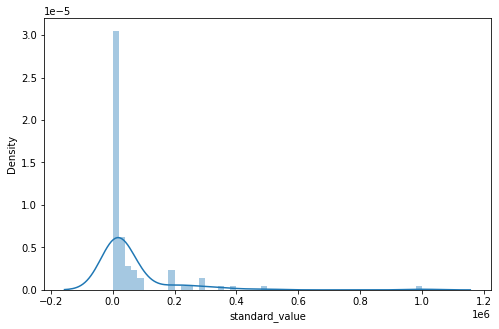

In [43]:
import seaborn as sns

plt.figure(figsize=(8,5))
sns.distplot(df6.standard_value)

### Now need to convert IC50 to negative log scale (-log10(IC50)) which gives us a more uniform distribution for prediction.

In [44]:
def pIC50(input):
    pIC50 = []

    for i in input['standard_value_norm']:
        molar = i*(10**-9) # Converts nanoMolar to Molar
        pIC50.append(-np.log10(molar))

    input['pIC50'] = pIC50
    x = input.drop('standard_value_norm', 1)
        
    return x

### We will max out values at 100000000 to make it easier for us.  This gets rid of negative values if negative log is calculated.

In [45]:
df6.standard_value.dropna(inplace=True)

In [46]:
df6.standard_value = pd.to_numeric(df6.standard_value).astype(float)

In [47]:
def norm_value(input):
    norm = []

    for i in input['standard_value']:
        if i > 100000000:
          i = 100000000
        norm.append(i)

    input['standard_value_norm'] = norm
    x = input.drop('standard_value', 1)
        
    return x

In [48]:
df_normalized = norm_value(df6)
df_normalized.head(10)

,molecule_chembl_id,canonical_smiles,bioactivity_class,MW,LogP,NumHDonors,NumHAcceptors,standard_value_norm
0,CHEMBL187579,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,intermediate,299.286,1.11984,1.0,5.0,7200.0
1,CHEMBL188487,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,intermediate,281.271,1.89262,0.0,5.0,9400.0
2,CHEMBL185698,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,inactive,415.589,3.81320,0.0,2.0,13500.0
3,CHEMBL426082,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21,inactive,421.190,2.66050,0.0,4.0,13110.0
4,CHEMBL187717,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-],intermediate,403.175,3.76690,0.0,3.0,2000.0
5,CHEMBL365134,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c(Br)cccc21,active,307.305,3.17090,0.0,4.0,980.0
6,CHEMBL187598,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccc(F)cc21,intermediate,322.276,3.07050,0.0,5.0,4820.0
7,CHEMBL190743,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccc(I)cc21,active,293.347,3.63080,0.0,3.0,950.0
8,CHEMBL365469,O=C1C(=O)N(Cc2cc3ccccc3s2)c2cccc(Cl)c21,inactive,338.344,3.53900,0.0,5.0,11200.0
9,CHEMBL188983,O=C1C(=O)N(C/C=C/c2cc3ccccc3s2)c2ccc(I)cc21,inactive,308.362,3.21300,1.0,4.0,23500.0


In [49]:
df7 = pIC50(df_normalized)
df7.head(10)

,molecule_chembl_id,canonical_smiles,bioactivity_class,MW,LogP,NumHDonors,NumHAcceptors,pIC50
0,CHEMBL187579,Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21,intermediate,299.286,1.11984,1.0,5.0,5.142668
1,CHEMBL188487,O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21,intermediate,281.271,1.89262,0.0,5.0,5.026872
2,CHEMBL185698,O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21,inactive,415.589,3.81320,0.0,2.0,4.869666
3,CHEMBL426082,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21,inactive,421.190,2.66050,0.0,4.0,4.882397
4,CHEMBL187717,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-],intermediate,403.175,3.76690,0.0,3.0,5.698970
5,CHEMBL365134,O=C1C(=O)N(Cc2cc3ccccc3s2)c2c(Br)cccc21,active,307.305,3.17090,0.0,4.0,6.008774
6,CHEMBL187598,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccc(F)cc21,intermediate,322.276,3.07050,0.0,5.0,5.316953
7,CHEMBL190743,O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccc(I)cc21,active,293.347,3.63080,0.0,3.0,6.022276
8,CHEMBL365469,O=C1C(=O)N(Cc2cc3ccccc3s2)c2cccc(Cl)c21,inactive,338.344,3.53900,0.0,5.0,4.950782
9,CHEMBL188983,O=C1C(=O)N(C/C=C/c2cc3ccccc3s2)c2ccc(I)cc21,inactive,308.362,3.21300,1.0,4.0,4.628932


/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


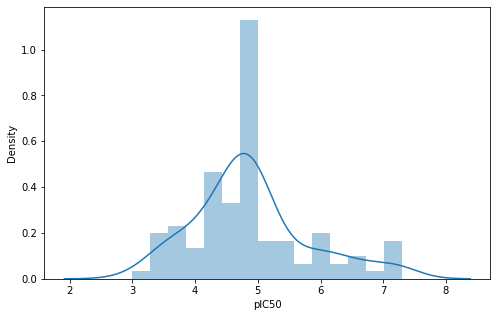

In [50]:
plt.figure(figsize=(8,5))
sns.distplot(df7.pIC50)

In [51]:
df7.pIC50.describe()

count    105.000000
mean       4.876188
std        0.919190
min        3.000000
25%        4.346787
50%        4.823909
75%        5.055517
max        7.301030
Name: pIC50, dtype: float64

### Removing intermediate class

In [52]:
df_2class = df7[df7.bioactivity_class != 'intermediate']

Looking at Active vs Inactive molecules

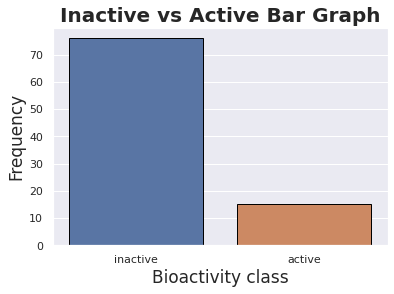

In [53]:
sns.set(style='darkgrid')
sns.countplot(x='bioactivity_class', data = df_2class, edgecolor='black')

plt.xlabel('Bioactivity class', fontsize = 17)
plt.ylabel('Frequency', fontsize = 17)
plt.title('Inactive vs Active Bar Graph', size = 20, fontweight = 'bold')

plt.savefig('plot_bioactivity_class.png')

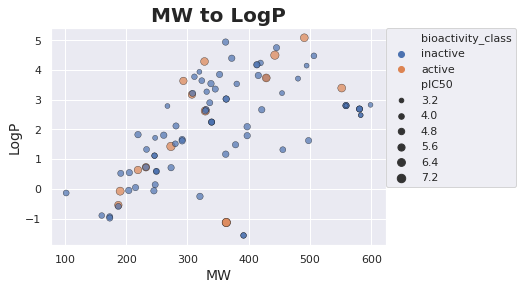

In [54]:
sns.scatterplot(x='MW', y='LogP', data=df_2class, hue='bioactivity_class', size='pIC50', edgecolor='black', alpha=0.7)

plt.xlabel('MW', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('MW to LogP', size = 20, fontweight = 'bold')
plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0, fancybox = True)

plt.savefig('plot_MW_vs_LogP.png')

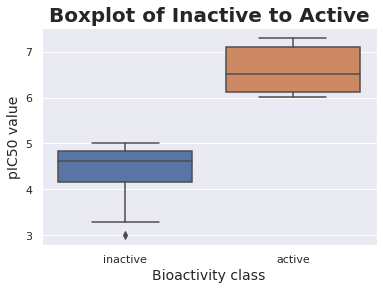

In [55]:
sns.boxplot(x = 'bioactivity_class', y = 'pIC50', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('pIC50 value', fontsize=14)
plt.title('Boxplot of Inactive to Active', size = 20, fontweight = 'bold')

plt.savefig('plot_ic50.png')

### Now a Mann-Whitney U Test to make sure both groups are statistically different.  This MannWhitney test is for active vs inactive bioactivity.

In [56]:
def mannwhitney(descriptor, verbose=True):
    from numpy.random import seed
    from numpy.random import randn
    from scipy.stats import mannwhitneyu


    seed(42)

### actives and inactives
    selection = [descriptor, 'bioactivity_class']
    df = df_2class[selection]
    active = df[df.bioactivity_class == 'active']
    active = active[descriptor]

    selection = [descriptor, 'bioactivity_class']
    df = df_2class[selection]
    inactive = df[df.bioactivity_class == 'inactive']
    inactive = inactive[descriptor]

### comparing samples
    stat, p = mannwhitneyu(active, inactive)
    print('Statistics=%.3f, p=%.3f' % (stat, p))

### interpret
    alpha = 0.05
    if p > alpha:
        interpretation = 'Same distribution (fail to reject H0)'
    else:
        interpretation = 'Different distribution (reject H0)'
  
    results = pd.DataFrame({'Descriptor':descriptor,
                          'Statistics':stat,
                          'p':p,
                          'alpha':alpha,
                          'Interpretation':interpretation}, index=[0])
    #filename = 'mannwhitneyu_' + descriptor + '.csv'
    #results.to_csv(filename)

    return results

In [57]:
mannwhitney('pIC50')

Statistics=0.000, p=0.000


,Descriptor,Statistics,p,alpha,Interpretation
0,pIC50,0.0,5.526323e-10,0.05,Different distribution (reject H0)


Molecular Weight

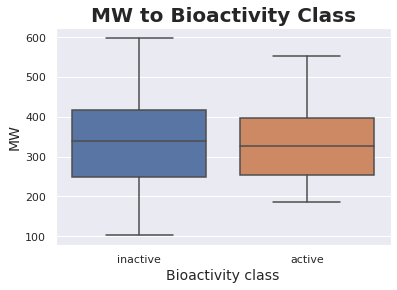

In [58]:
sns.boxplot(x = 'bioactivity_class', y = 'MW', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('MW', fontsize=14)
plt.title('MW to Bioactivity Class', size = 20, fontweight = 'bold')

plt.savefig('plot_MW.png')

In [59]:
mannwhitney('MW')

Statistics=514.000, p=0.276


,Descriptor,Statistics,p,alpha,Interpretation
0,MW,514.0,0.276343,0.05,Same distribution (fail to reject H0)


LogP

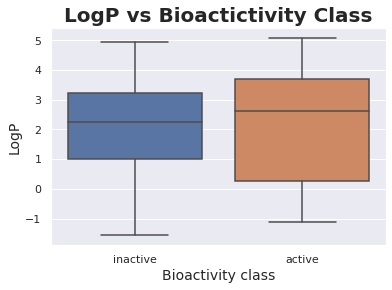

In [60]:
sns.boxplot(x = 'bioactivity_class', y = 'LogP', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('LogP vs Bioactictivity Class', size = 20, fontweight='bold')

plt.savefig('plot_LogP.png')

In [61]:
mannwhitney('LogP')

Statistics=560.500, p=0.462


,Descriptor,Statistics,p,alpha,Interpretation
0,LogP,560.5,0.461649,0.05,Same distribution (fail to reject H0)


Number of Hydrogen Donors

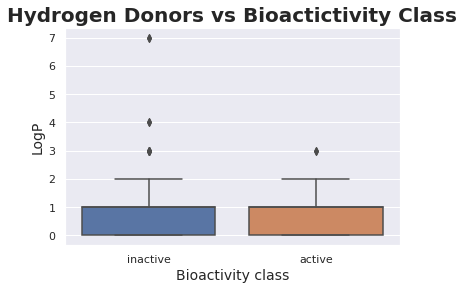

In [62]:
sns.boxplot(x = 'bioactivity_class', y = 'NumHDonors', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('Hydrogen Donors vs Bioactictivity Class', size = 20, fontweight='bold')

plt.savefig('plot_NumHDonors.png')

In [63]:
mannwhitney('NumHDonors')

Statistics=540.500, p=0.370


,Descriptor,Statistics,p,alpha,Interpretation
0,NumHDonors,540.5,0.369717,0.05,Same distribution (fail to reject H0)


Number of Hydrogen Acceptors

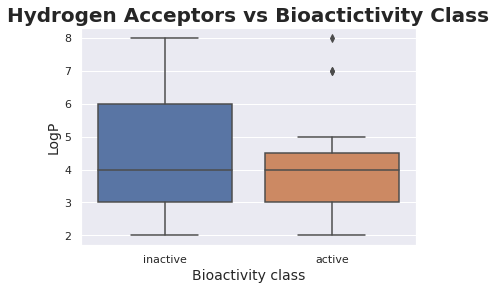

In [64]:
sns.boxplot(x = 'bioactivity_class', y = 'NumHAcceptors', data = df_2class)

plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel('LogP', fontsize=14)
plt.title('Hydrogen Acceptors vs Bioactictivity Class', size = 20, fontweight='bold')

plt.savefig('plot_NumHacceptors.png')

In [65]:
mannwhitney('NumHAcceptors')

Statistics=509.000, p=0.254


,Descriptor,Statistics,p,alpha,Interpretation
0,NumHAcceptors,509.0,0.254482,0.05,Same distribution (fail to reject H0)


### Interpretations

### pIC50 ------------ Statistically significant (This is expected as we pre-processed this data to split active and inactive)
### MW -------------- Not significant
### LogP ------------ Not significant
### H Donors ------ Not significant
### H Acceptors -- Not significant

In [66]:
df_2class.to_csv('df_2class.csv', index=False)

We will now use PaDEL to calculate the molecular descriptors.

In [67]:
! wget https://github.com/dataprofessor/bioinformatics/raw/master/padel.zip
! wget https://github.com/dataprofessor/bioinformatics/raw/master/padel.sh

--2020-10-25 11:30:33--  https://github.com/dataprofessor/bioinformatics/raw/master/padel.zip
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.zip [following]
--2020-10-25 11:30:33--  https://raw.githubusercontent.com/dataprofessor/bioinformatics/master/padel.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 25768637 (25M) [application/zip]
Saving to: ‘padel.zip’

padel.zip           100%[===================>]  24.57M  54.3MB/s    in 0.5s    

2020-10-25 11:30:34 (54.3 MB/s) - ‘padel.zip’ saved [25768637/25768637]

--2020-10-25 11:30:34--  https://github

In [68]:
! unzip padel.zip

Archive:  padel.zip
   creating: PaDEL-Descriptor/
  inflating: __MACOSX/._PaDEL-Descriptor  
  inflating: PaDEL-Descriptor/MACCSFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._MACCSFingerprinter.xml  
  inflating: PaDEL-Descriptor/AtomPairs2DFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._AtomPairs2DFingerprinter.xml  
  inflating: PaDEL-Descriptor/EStateFingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._EStateFingerprinter.xml  
  inflating: PaDEL-Descriptor/Fingerprinter.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._Fingerprinter.xml  
  inflating: PaDEL-Descriptor/.DS_Store  
  inflating: __MACOSX/PaDEL-Descriptor/._.DS_Store  
   creating: PaDEL-Descriptor/license/
  inflating: __MACOSX/PaDEL-Descriptor/._license  
  inflating: PaDEL-Descriptor/KlekotaRothFingerprintCount.xml  
  inflating: __MACOSX/PaDEL-Descriptor/._KlekotaRothFingerprintCount.xml  
  inflating: PaDEL-Descriptor/config  
  inflating: __MACOSX/PaDEL-Descriptor/._config  
  inf

In [69]:
df_2class.dropna(inplace=True)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [70]:
selection = ['canonical_smiles','molecule_chembl_id']
df3_selection = df3[selection]
df3_selection.to_csv('molecule.smi', sep='\t', index=False, header=False)

In [71]:
! cat molecule.smi | head -5

Cc1noc(C)c1CN1C(=O)C(=O)c2cc(C#N)ccc21	CHEMBL187579
O=C1C(=O)N(Cc2ccc(F)cc2Cl)c2ccc(I)cc21	CHEMBL188487
O=C1C(=O)N(CC2COc3ccccc3O2)c2ccc(I)cc21	CHEMBL185698
O=C1C(=O)N(Cc2cc3ccccc3s2)c2ccccc21	CHEMBL426082
O=C1C(=O)N(Cc2cc3ccccc3s2)c2c1cccc2[N+](=O)[O-]	CHEMBL187717


In [72]:
 cat molecule.smi | wc -l   ### We have 215 molecules to look transcribe.

105


Calculating descriptors

In [73]:
! cat padel.sh

java -Xms1G -Xmx1G -Djava.awt.headless=true -jar ./PaDEL-Descriptor/PaDEL-Descriptor.jar -removesalt -standardizenitro -fingerprints -descriptortypes ./PaDEL-Descriptor/PubchemFingerprinter.xml -dir ./ -file descriptors_output.csv


### Showing what is inside padel file in above line of code.  This uses Java with 1 gig of memory.  We removed the sodium and chloride (salts) which are in the chemical structure.

In [74]:
! bash padel.sh

Processing CHEMBL187579 in molecule.smi (1/105). 
Processing CHEMBL188487 in molecule.smi (2/105). 
Processing CHEMBL185698 in molecule.smi (3/105). Average speed: 2.03 s/mol.
Processing CHEMBL426082 in molecule.smi (4/105). Average speed: 1.06 s/mol.
Processing CHEMBL187717 in molecule.smi (5/105). Average speed: 0.90 s/mol.
Processing CHEMBL365134 in molecule.smi (6/105). Average speed: 0.72 s/mol.
Processing CHEMBL187598 in molecule.smi (7/105). Average speed: 0.68 s/mol.
Processing CHEMBL190743 in molecule.smi (8/105). Average speed: 0.62 s/mol.
Processing CHEMBL365469 in molecule.smi (9/105). Average speed: 0.58 s/mol.
Processing CHEMBL188983 in molecule.smi (10/105). Average speed: 0.55 s/mol.
Processing CHEMBL191575 in molecule.smi (11/105). Average speed: 0.52 s/mol.
Processing CHEMBL370923 in molecule.smi (12/105). Average speed: 0.50 s/mol.
Processing CHEMBL194398 in molecule.smi (13/105). Average speed: 0.49 s/mol.
Processing CHEMBL196635 in molecule.smi (14/105). Average sp

Preparing the X and Y Data Matrices

X Matrix

In [75]:
df_X_matrix = pd.read_csv('descriptors_output.csv')

In [76]:
df_X_matrix

,Name,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,PubchemFP22,PubchemFP23,PubchemFP24,PubchemFP25,PubchemFP26,PubchemFP27,PubchemFP28,PubchemFP29,PubchemFP30,PubchemFP31,PubchemFP32,PubchemFP33,PubchemFP34,PubchemFP35,PubchemFP36,PubchemFP37,PubchemFP38,PubchemFP39,PubchemFP40,PubchemFP41,PubchemFP42,PubchemFP43,PubchemFP44,PubchemFP45,PubchemFP46,PubchemFP47,PubchemFP48,PubchemFP49,PubchemFP50,PubchemFP51,PubchemFP52,PubchemFP53,PubchemFP54,PubchemFP55,PubchemFP56,PubchemFP57,PubchemFP58,PubchemFP59,PubchemFP60,PubchemFP61,PubchemFP62,PubchemFP63,PubchemFP64,PubchemFP65,PubchemFP66,PubchemFP67,PubchemFP68,PubchemFP69,PubchemFP70,PubchemFP71,PubchemFP72,PubchemFP73,PubchemFP74,PubchemFP75,PubchemFP76,PubchemFP77,PubchemFP78,PubchemFP79,PubchemFP80,PubchemFP81,PubchemFP82,PubchemFP83,PubchemFP84,PubchemFP85,PubchemFP86,PubchemFP87,PubchemFP88,PubchemFP89,PubchemFP90,PubchemFP91,PubchemFP92,PubchemFP93,PubchemFP94,PubchemFP95,PubchemFP96,PubchemFP97,PubchemFP98,PubchemFP99,PubchemFP100,PubchemFP101,PubchemFP102,PubchemFP103,PubchemFP104,PubchemFP105,PubchemFP106,PubchemFP107,PubchemFP108,PubchemFP109,PubchemFP110,PubchemFP111,PubchemFP112,PubchemFP113,PubchemFP114,PubchemFP115,PubchemFP116,PubchemFP117,PubchemFP118,PubchemFP119,PubchemFP120,PubchemFP121,PubchemFP122,PubchemFP123,PubchemFP124,PubchemFP125,PubchemFP126,PubchemFP127,PubchemFP128,PubchemFP129,PubchemFP130,PubchemFP131,PubchemFP132,PubchemFP133,PubchemFP134,PubchemFP135,PubchemFP136,PubchemFP137,PubchemFP138,PubchemFP139,PubchemFP140,PubchemFP141,PubchemFP142,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP147,PubchemFP148,PubchemFP149,PubchemFP150,PubchemFP151,PubchemFP152,PubchemFP153,PubchemFP154,PubchemFP155,PubchemFP156,PubchemFP157,PubchemFP158,PubchemFP159,PubchemFP160,PubchemFP161,PubchemFP162,PubchemFP163,PubchemFP164,PubchemFP165,PubchemFP166,PubchemFP167,PubchemFP168,PubchemFP169,PubchemFP170,PubchemFP171,PubchemFP172,PubchemFP173,PubchemFP174,PubchemFP175,PubchemFP176,PubchemFP177,PubchemFP178,PubchemFP179,PubchemFP180,PubchemFP181,PubchemFP182,PubchemFP183,PubchemFP184,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP189,PubchemFP190,PubchemFP191,PubchemFP192,PubchemFP193,PubchemFP194,PubchemFP195,PubchemFP196,PubchemFP197,PubchemFP198,PubchemFP199,PubchemFP200,PubchemFP201,PubchemFP202,PubchemFP203,PubchemFP204,PubchemFP205,PubchemFP206,PubchemFP207,PubchemFP208,PubchemFP209,PubchemFP210,PubchemFP211,PubchemFP212,PubchemFP213,PubchemFP214,PubchemFP215,PubchemFP216,PubchemFP217,PubchemFP218,PubchemFP219,PubchemFP220,PubchemFP221,PubchemFP222,PubchemFP223,PubchemFP224,PubchemFP225,PubchemFP226,PubchemFP227,PubchemFP228,PubchemFP229,PubchemFP230,PubchemFP231,PubchemFP232,PubchemFP233,PubchemFP234,PubchemFP235,PubchemFP236,PubchemFP237,PubchemFP238,PubchemFP239,PubchemFP240,PubchemFP241,PubchemFP242,PubchemFP243,PubchemFP244,PubchemFP245,PubchemFP246,PubchemFP247,PubchemFP248,PubchemFP249,PubchemFP250,PubchemFP251,PubchemFP252,PubchemFP253,PubchemFP254,PubchemFP255,PubchemFP256,PubchemFP257,PubchemFP258,PubchemFP259,PubchemFP260,PubchemFP261,PubchemFP262,PubchemFP263,PubchemFP264,PubchemFP265,PubchemFP266,PubchemFP267,PubchemFP268,PubchemFP269,PubchemFP270,PubchemFP271,PubchemFP272,PubchemFP273,PubchemFP274,PubchemFP275,PubchemFP276,PubchemFP277,PubchemFP278,PubchemFP279,PubchemFP280,PubchemFP281,PubchemFP282,PubchemFP283,PubchemFP284,PubchemFP285,PubchemFP286,PubchemFP287,PubchemFP288,PubchemFP289,PubchemFP290,PubchemFP291,PubchemFP292,PubchemFP293,PubchemFP294,PubchemFP295,PubchemFP296,PubchemFP297,PubchemFP298,PubchemFP299,PubchemFP300,PubchemFP301,PubchemFP302,PubchemFP303,PubchemFP304,PubchemFP305,PubchemFP306,PubchemFP307,PubchemFP308,PubchemFP309,PubchemFP310,PubchemFP311,PubchemFP312,PubchemFP313,PubchemFP314,PubchemFP

In [77]:
df_X_matrix = df_X_matrix.drop(columns=['Name'])
df_X_matrix

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,PubchemFP22,PubchemFP23,PubchemFP24,PubchemFP25,PubchemFP26,PubchemFP27,PubchemFP28,PubchemFP29,PubchemFP30,PubchemFP31,PubchemFP32,PubchemFP33,PubchemFP34,PubchemFP35,PubchemFP36,PubchemFP37,PubchemFP38,PubchemFP39,PubchemFP40,PubchemFP41,PubchemFP42,PubchemFP43,PubchemFP44,PubchemFP45,PubchemFP46,PubchemFP47,PubchemFP48,PubchemFP49,PubchemFP50,PubchemFP51,PubchemFP52,PubchemFP53,PubchemFP54,PubchemFP55,PubchemFP56,PubchemFP57,PubchemFP58,PubchemFP59,PubchemFP60,PubchemFP61,PubchemFP62,PubchemFP63,PubchemFP64,PubchemFP65,PubchemFP66,PubchemFP67,PubchemFP68,PubchemFP69,PubchemFP70,PubchemFP71,PubchemFP72,PubchemFP73,PubchemFP74,PubchemFP75,PubchemFP76,PubchemFP77,PubchemFP78,PubchemFP79,PubchemFP80,PubchemFP81,PubchemFP82,PubchemFP83,PubchemFP84,PubchemFP85,PubchemFP86,PubchemFP87,PubchemFP88,PubchemFP89,PubchemFP90,PubchemFP91,PubchemFP92,PubchemFP93,PubchemFP94,PubchemFP95,PubchemFP96,PubchemFP97,PubchemFP98,PubchemFP99,PubchemFP100,PubchemFP101,PubchemFP102,PubchemFP103,PubchemFP104,PubchemFP105,PubchemFP106,PubchemFP107,PubchemFP108,PubchemFP109,PubchemFP110,PubchemFP111,PubchemFP112,PubchemFP113,PubchemFP114,PubchemFP115,PubchemFP116,PubchemFP117,PubchemFP118,PubchemFP119,PubchemFP120,PubchemFP121,PubchemFP122,PubchemFP123,PubchemFP124,PubchemFP125,PubchemFP126,PubchemFP127,PubchemFP128,PubchemFP129,PubchemFP130,PubchemFP131,PubchemFP132,PubchemFP133,PubchemFP134,PubchemFP135,PubchemFP136,PubchemFP137,PubchemFP138,PubchemFP139,PubchemFP140,PubchemFP141,PubchemFP142,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP147,PubchemFP148,PubchemFP149,PubchemFP150,PubchemFP151,PubchemFP152,PubchemFP153,PubchemFP154,PubchemFP155,PubchemFP156,PubchemFP157,PubchemFP158,PubchemFP159,PubchemFP160,PubchemFP161,PubchemFP162,PubchemFP163,PubchemFP164,PubchemFP165,PubchemFP166,PubchemFP167,PubchemFP168,PubchemFP169,PubchemFP170,PubchemFP171,PubchemFP172,PubchemFP173,PubchemFP174,PubchemFP175,PubchemFP176,PubchemFP177,PubchemFP178,PubchemFP179,PubchemFP180,PubchemFP181,PubchemFP182,PubchemFP183,PubchemFP184,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP189,PubchemFP190,PubchemFP191,PubchemFP192,PubchemFP193,PubchemFP194,PubchemFP195,PubchemFP196,PubchemFP197,PubchemFP198,PubchemFP199,PubchemFP200,PubchemFP201,PubchemFP202,PubchemFP203,PubchemFP204,PubchemFP205,PubchemFP206,PubchemFP207,PubchemFP208,PubchemFP209,PubchemFP210,PubchemFP211,PubchemFP212,PubchemFP213,PubchemFP214,PubchemFP215,PubchemFP216,PubchemFP217,PubchemFP218,PubchemFP219,PubchemFP220,PubchemFP221,PubchemFP222,PubchemFP223,PubchemFP224,PubchemFP225,PubchemFP226,PubchemFP227,PubchemFP228,PubchemFP229,PubchemFP230,PubchemFP231,PubchemFP232,PubchemFP233,PubchemFP234,PubchemFP235,PubchemFP236,PubchemFP237,PubchemFP238,PubchemFP239,PubchemFP240,PubchemFP241,PubchemFP242,PubchemFP243,PubchemFP244,PubchemFP245,PubchemFP246,PubchemFP247,PubchemFP248,PubchemFP249,PubchemFP250,PubchemFP251,PubchemFP252,PubchemFP253,PubchemFP254,PubchemFP255,PubchemFP256,PubchemFP257,PubchemFP258,PubchemFP259,PubchemFP260,PubchemFP261,PubchemFP262,PubchemFP263,PubchemFP264,PubchemFP265,PubchemFP266,PubchemFP267,PubchemFP268,PubchemFP269,PubchemFP270,PubchemFP271,PubchemFP272,PubchemFP273,PubchemFP274,PubchemFP275,PubchemFP276,PubchemFP277,PubchemFP278,PubchemFP279,PubchemFP280,PubchemFP281,PubchemFP282,PubchemFP283,PubchemFP284,PubchemFP285,PubchemFP286,PubchemFP287,PubchemFP288,PubchemFP289,PubchemFP290,PubchemFP291,PubchemFP292,PubchemFP293,PubchemFP294,PubchemFP295,PubchemFP296,PubchemFP297,PubchemFP298,PubchemFP299,PubchemFP300,PubchemFP301,PubchemFP302,PubchemFP303,PubchemFP304,PubchemFP305,PubchemFP306,PubchemFP307,PubchemFP308,PubchemFP309,PubchemFP310,PubchemFP311,PubchemFP312,PubchemFP313,PubchemFP314,PubchemFP315,P

### Y variable

COnverting IC50 to pIC50

In [78]:
df_y = df7['pIC50']
df_y.dropna(inplace=True)

In [79]:
df_y

0      5.142668
1      5.026872
2      4.869666
3      4.882397
4      5.698970
5      6.008774
6      5.316953
7      6.022276
8      4.950782
9      4.628932
10     4.900665
11     4.756962
12     4.346787
13     4.154902
14     4.180456
15     6.431798
16     4.903090
17     4.721246
18     4.602060
19     4.148742
20     5.958607
21     4.301030
22     5.522879
23     3.522879
24     3.602060
25     3.698970
26     4.000000
27     4.221849
28     4.346787
29     4.397940
30     4.823909
31     4.823909
32     4.920819
33     3.000000
34     3.301030
35     3.397940
36     3.455932
37     3.522879
38     3.522879
39     3.698970
40     3.698970
41     3.698970
42     3.698970
43     4.221849
44     4.397940
45     4.522879
46     4.823909
47     4.853872
48     4.958607
49     5.000000
50     6.045757
51     5.221849
52     4.920819
53     4.886057
54     4.886057
55     4.823909
56     4.795880
57     4.795880
58     4.795880
59     4.602060
60     4.494850
61     5.522879
62     5

Combining

In [80]:
final_dataset = pd.concat([df_X_matrix,df_y], axis=1)

In [81]:
missdata = df.isnull().values.any()
print(missdata)

True


In [86]:
if missdata == True:
    print('# of missing values:', final_dataset.isnull().values.sum())
else:
    print('No missing data')

# of missing values: 0


In [87]:
final_dataset.isnull().sum()

PubchemFP0      0
PubchemFP1      0
PubchemFP2      0
PubchemFP3      0
PubchemFP4      0
               ..
PubchemFP877    0
PubchemFP878    0
PubchemFP879    0
PubchemFP880    0
pIC50           0
Length: 882, dtype: int64

In [88]:
final_dataset = final_dataset.dropna(axis=0)   ### Removing one final NaN value found in matrix.

In [89]:
final_dataset

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,PubchemFP22,PubchemFP23,PubchemFP24,PubchemFP25,PubchemFP26,PubchemFP27,PubchemFP28,PubchemFP29,PubchemFP30,PubchemFP31,PubchemFP32,PubchemFP33,PubchemFP34,PubchemFP35,PubchemFP36,PubchemFP37,PubchemFP38,PubchemFP39,PubchemFP40,PubchemFP41,PubchemFP42,PubchemFP43,PubchemFP44,PubchemFP45,PubchemFP46,PubchemFP47,PubchemFP48,PubchemFP49,PubchemFP50,PubchemFP51,PubchemFP52,PubchemFP53,PubchemFP54,PubchemFP55,PubchemFP56,PubchemFP57,PubchemFP58,PubchemFP59,PubchemFP60,PubchemFP61,PubchemFP62,PubchemFP63,PubchemFP64,PubchemFP65,PubchemFP66,PubchemFP67,PubchemFP68,PubchemFP69,PubchemFP70,PubchemFP71,PubchemFP72,PubchemFP73,PubchemFP74,PubchemFP75,PubchemFP76,PubchemFP77,PubchemFP78,PubchemFP79,PubchemFP80,PubchemFP81,PubchemFP82,PubchemFP83,PubchemFP84,PubchemFP85,PubchemFP86,PubchemFP87,PubchemFP88,PubchemFP89,PubchemFP90,PubchemFP91,PubchemFP92,PubchemFP93,PubchemFP94,PubchemFP95,PubchemFP96,PubchemFP97,PubchemFP98,PubchemFP99,PubchemFP100,PubchemFP101,PubchemFP102,PubchemFP103,PubchemFP104,PubchemFP105,PubchemFP106,PubchemFP107,PubchemFP108,PubchemFP109,PubchemFP110,PubchemFP111,PubchemFP112,PubchemFP113,PubchemFP114,PubchemFP115,PubchemFP116,PubchemFP117,PubchemFP118,PubchemFP119,PubchemFP120,PubchemFP121,PubchemFP122,PubchemFP123,PubchemFP124,PubchemFP125,PubchemFP126,PubchemFP127,PubchemFP128,PubchemFP129,PubchemFP130,PubchemFP131,PubchemFP132,PubchemFP133,PubchemFP134,PubchemFP135,PubchemFP136,PubchemFP137,PubchemFP138,PubchemFP139,PubchemFP140,PubchemFP141,PubchemFP142,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP147,PubchemFP148,PubchemFP149,PubchemFP150,PubchemFP151,PubchemFP152,PubchemFP153,PubchemFP154,PubchemFP155,PubchemFP156,PubchemFP157,PubchemFP158,PubchemFP159,PubchemFP160,PubchemFP161,PubchemFP162,PubchemFP163,PubchemFP164,PubchemFP165,PubchemFP166,PubchemFP167,PubchemFP168,PubchemFP169,PubchemFP170,PubchemFP171,PubchemFP172,PubchemFP173,PubchemFP174,PubchemFP175,PubchemFP176,PubchemFP177,PubchemFP178,PubchemFP179,PubchemFP180,PubchemFP181,PubchemFP182,PubchemFP183,PubchemFP184,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP189,PubchemFP190,PubchemFP191,PubchemFP192,PubchemFP193,PubchemFP194,PubchemFP195,PubchemFP196,PubchemFP197,PubchemFP198,PubchemFP199,PubchemFP200,PubchemFP201,PubchemFP202,PubchemFP203,PubchemFP204,PubchemFP205,PubchemFP206,PubchemFP207,PubchemFP208,PubchemFP209,PubchemFP210,PubchemFP211,PubchemFP212,PubchemFP213,PubchemFP214,PubchemFP215,PubchemFP216,PubchemFP217,PubchemFP218,PubchemFP219,PubchemFP220,PubchemFP221,PubchemFP222,PubchemFP223,PubchemFP224,PubchemFP225,PubchemFP226,PubchemFP227,PubchemFP228,PubchemFP229,PubchemFP230,PubchemFP231,PubchemFP232,PubchemFP233,PubchemFP234,PubchemFP235,PubchemFP236,PubchemFP237,PubchemFP238,PubchemFP239,PubchemFP240,PubchemFP241,PubchemFP242,PubchemFP243,PubchemFP244,PubchemFP245,PubchemFP246,PubchemFP247,PubchemFP248,PubchemFP249,PubchemFP250,PubchemFP251,PubchemFP252,PubchemFP253,PubchemFP254,PubchemFP255,PubchemFP256,PubchemFP257,PubchemFP258,PubchemFP259,PubchemFP260,PubchemFP261,PubchemFP262,PubchemFP263,PubchemFP264,PubchemFP265,PubchemFP266,PubchemFP267,PubchemFP268,PubchemFP269,PubchemFP270,PubchemFP271,PubchemFP272,PubchemFP273,PubchemFP274,PubchemFP275,PubchemFP276,PubchemFP277,PubchemFP278,PubchemFP279,PubchemFP280,PubchemFP281,PubchemFP282,PubchemFP283,PubchemFP284,PubchemFP285,PubchemFP286,PubchemFP287,PubchemFP288,PubchemFP289,PubchemFP290,PubchemFP291,PubchemFP292,PubchemFP293,PubchemFP294,PubchemFP295,PubchemFP296,PubchemFP297,PubchemFP298,PubchemFP299,PubchemFP300,PubchemFP301,PubchemFP302,PubchemFP303,PubchemFP304,PubchemFP305,PubchemFP306,PubchemFP307,PubchemFP308,PubchemFP309,PubchemFP310,PubchemFP311,PubchemFP312,PubchemFP313,PubchemFP314,PubchemFP315,P

In [90]:
final_dataset.to_csv('final_dataset,csv', index=False)

#Modeling

In [91]:
final_dataset = pd.read_csv('final_dataset,csv')

In [92]:
final_dataset

,PubchemFP0,PubchemFP1,PubchemFP2,PubchemFP3,PubchemFP4,PubchemFP5,PubchemFP6,PubchemFP7,PubchemFP8,PubchemFP9,PubchemFP10,PubchemFP11,PubchemFP12,PubchemFP13,PubchemFP14,PubchemFP15,PubchemFP16,PubchemFP17,PubchemFP18,PubchemFP19,PubchemFP20,PubchemFP21,PubchemFP22,PubchemFP23,PubchemFP24,PubchemFP25,PubchemFP26,PubchemFP27,PubchemFP28,PubchemFP29,PubchemFP30,PubchemFP31,PubchemFP32,PubchemFP33,PubchemFP34,PubchemFP35,PubchemFP36,PubchemFP37,PubchemFP38,PubchemFP39,PubchemFP40,PubchemFP41,PubchemFP42,PubchemFP43,PubchemFP44,PubchemFP45,PubchemFP46,PubchemFP47,PubchemFP48,PubchemFP49,PubchemFP50,PubchemFP51,PubchemFP52,PubchemFP53,PubchemFP54,PubchemFP55,PubchemFP56,PubchemFP57,PubchemFP58,PubchemFP59,PubchemFP60,PubchemFP61,PubchemFP62,PubchemFP63,PubchemFP64,PubchemFP65,PubchemFP66,PubchemFP67,PubchemFP68,PubchemFP69,PubchemFP70,PubchemFP71,PubchemFP72,PubchemFP73,PubchemFP74,PubchemFP75,PubchemFP76,PubchemFP77,PubchemFP78,PubchemFP79,PubchemFP80,PubchemFP81,PubchemFP82,PubchemFP83,PubchemFP84,PubchemFP85,PubchemFP86,PubchemFP87,PubchemFP88,PubchemFP89,PubchemFP90,PubchemFP91,PubchemFP92,PubchemFP93,PubchemFP94,PubchemFP95,PubchemFP96,PubchemFP97,PubchemFP98,PubchemFP99,PubchemFP100,PubchemFP101,PubchemFP102,PubchemFP103,PubchemFP104,PubchemFP105,PubchemFP106,PubchemFP107,PubchemFP108,PubchemFP109,PubchemFP110,PubchemFP111,PubchemFP112,PubchemFP113,PubchemFP114,PubchemFP115,PubchemFP116,PubchemFP117,PubchemFP118,PubchemFP119,PubchemFP120,PubchemFP121,PubchemFP122,PubchemFP123,PubchemFP124,PubchemFP125,PubchemFP126,PubchemFP127,PubchemFP128,PubchemFP129,PubchemFP130,PubchemFP131,PubchemFP132,PubchemFP133,PubchemFP134,PubchemFP135,PubchemFP136,PubchemFP137,PubchemFP138,PubchemFP139,PubchemFP140,PubchemFP141,PubchemFP142,PubchemFP143,PubchemFP144,PubchemFP145,PubchemFP146,PubchemFP147,PubchemFP148,PubchemFP149,PubchemFP150,PubchemFP151,PubchemFP152,PubchemFP153,PubchemFP154,PubchemFP155,PubchemFP156,PubchemFP157,PubchemFP158,PubchemFP159,PubchemFP160,PubchemFP161,PubchemFP162,PubchemFP163,PubchemFP164,PubchemFP165,PubchemFP166,PubchemFP167,PubchemFP168,PubchemFP169,PubchemFP170,PubchemFP171,PubchemFP172,PubchemFP173,PubchemFP174,PubchemFP175,PubchemFP176,PubchemFP177,PubchemFP178,PubchemFP179,PubchemFP180,PubchemFP181,PubchemFP182,PubchemFP183,PubchemFP184,PubchemFP185,PubchemFP186,PubchemFP187,PubchemFP188,PubchemFP189,PubchemFP190,PubchemFP191,PubchemFP192,PubchemFP193,PubchemFP194,PubchemFP195,PubchemFP196,PubchemFP197,PubchemFP198,PubchemFP199,PubchemFP200,PubchemFP201,PubchemFP202,PubchemFP203,PubchemFP204,PubchemFP205,PubchemFP206,PubchemFP207,PubchemFP208,PubchemFP209,PubchemFP210,PubchemFP211,PubchemFP212,PubchemFP213,PubchemFP214,PubchemFP215,PubchemFP216,PubchemFP217,PubchemFP218,PubchemFP219,PubchemFP220,PubchemFP221,PubchemFP222,PubchemFP223,PubchemFP224,PubchemFP225,PubchemFP226,PubchemFP227,PubchemFP228,PubchemFP229,PubchemFP230,PubchemFP231,PubchemFP232,PubchemFP233,PubchemFP234,PubchemFP235,PubchemFP236,PubchemFP237,PubchemFP238,PubchemFP239,PubchemFP240,PubchemFP241,PubchemFP242,PubchemFP243,PubchemFP244,PubchemFP245,PubchemFP246,PubchemFP247,PubchemFP248,PubchemFP249,PubchemFP250,PubchemFP251,PubchemFP252,PubchemFP253,PubchemFP254,PubchemFP255,PubchemFP256,PubchemFP257,PubchemFP258,PubchemFP259,PubchemFP260,PubchemFP261,PubchemFP262,PubchemFP263,PubchemFP264,PubchemFP265,PubchemFP266,PubchemFP267,PubchemFP268,PubchemFP269,PubchemFP270,PubchemFP271,PubchemFP272,PubchemFP273,PubchemFP274,PubchemFP275,PubchemFP276,PubchemFP277,PubchemFP278,PubchemFP279,PubchemFP280,PubchemFP281,PubchemFP282,PubchemFP283,PubchemFP284,PubchemFP285,PubchemFP286,PubchemFP287,PubchemFP288,PubchemFP289,PubchemFP290,PubchemFP291,PubchemFP292,PubchemFP293,PubchemFP294,PubchemFP295,PubchemFP296,PubchemFP297,PubchemFP298,PubchemFP299,PubchemFP300,PubchemFP301,PubchemFP302,PubchemFP303,PubchemFP304,PubchemFP305,PubchemFP306,PubchemFP307,PubchemFP308,PubchemFP309,PubchemFP310,PubchemFP311,PubchemFP312,PubchemFP313,PubchemFP314,PubchemFP315,P

# Testing different models by doing train-validation split

#Random Forest Regression

In [239]:
import pandas as pd
import numpy as np
from gensim.models import word2vec
import rdkit
from rdkit import Chem
#from mol2vec.features import mol2alt_sentence, mol2sentence, MolSentence, DfVec, sentences2vec
from gensim.models import word2vec
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error

In [240]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

In [241]:
X = final_dataset.drop('pIC50', axis=1).copy()
y = final_dataset.pIC50.copy()

In [242]:
X.shape

(105, 881)

In [243]:
y.shape

(105,)

In [244]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [246]:
y_pred = model.predict(X_test) 

In [248]:
import numpy as np
np.random.seed(100)
model = RandomForestRegressor(n_estimators=100)
model.fit(X_train, y_train)
R_square = model.score(X_test, y_test)
mse_rnf = mean_squared_error(y_test, y_pred)
mae_rnf = mean_absolute_error(y_test, y_pred)
print("r2_score: ", R_square)
print("MSE: ", mse_rnf)
print("MAE: ", mae_rnf)

r2_score:  -0.012727835269805476
MSE:  2.854756337761258
MAE:  1.4409248498863731


In [199]:
from sklearn.model_selection import cross_val_predict
#this is cross
from sklearn.model_selection import cross_val_score
scores = cross_val_predict(model, X_train, y_train, cv=5)
scores

array([4.3603188 , 4.68709235, 5.156836  , 5.24241142, 6.7694427 ,
       4.90150281, 4.75601105, 6.96249744, 4.72647238, 4.90150281,
       6.52441011, 4.61868112, 5.24241142, 4.83355957, 4.89079332,
       5.23496699, 4.86201616, 5.18904298, 4.44620441, 4.66281031,
       5.01511616, 3.5353617 , 4.94142639, 3.81203955, 4.41155686,
       5.36633579, 4.55114079, 4.41155686, 6.29716617, 5.42172671,
       5.0601582 , 4.76104292, 3.33068146, 4.51061091, 5.04932382,
       3.8666818 , 4.4487681 , 5.31606284, 4.44434983, 5.9783363 ,
       4.59974312, 5.05302225, 5.04904183, 3.70746874, 4.37345942,
       4.83887058, 4.83495115, 4.82084808, 4.20222142, 5.22821834,
       4.37345942, 5.13526526, 4.23314322, 4.22186271, 6.61430178,
       4.68703332, 4.73849827, 4.93362385, 4.63746483, 4.77958236,
       5.01279353, 4.75804347, 4.7526323 , 4.57334025, 4.99645746,
       3.77695604, 6.14289984, 4.98758107, 4.69385762, 4.8490932 ,
       4.14589448, 5.05307191, 4.88321317, 3.80590674, 4.03106

In [233]:
######
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split

scaler=StandardScaler()
xscalertrain=scaler.fit(X_train).transform(X_train)
xscalertest=scaler.fit(X_test).transform(X_test)
regr = MLPRegressor(random_state=1, activation='relu', max_iter=1000).fit(X_train, y_train)
regr.fit(xscalertrain, y_train)
#regr.predict(X_test[:2])
regtrain=regr.score(xscalertrain, y_train)
regtest=reg.score(xscalertest,y_test)
print('this is score for training',regtrain)
print('this is score for test',regtest)
scores = cross_val_score(regr, X_train, y_train, cv=5)
scores




this is score for training 0.8942961439093713
this is score for test -1.582597955134104


array([ 0.62666607, -0.91704007,  0.45446729,  0.41588136,  0.24857491])

Iteration 1, loss = 10.87041496
Iteration 2, loss = 7.52073897
Iteration 3, loss = 6.03580165
Iteration 4, loss = 4.80829153
Iteration 5, loss = 3.80230416
Iteration 6, loss = 2.98886265
Iteration 7, loss = 2.34097189
Iteration 8, loss = 1.83429373
Iteration 9, loss = 1.44489264
Iteration 10, loss = 1.15257163
Iteration 11, loss = 0.94075385
Iteration 12, loss = 0.79377246
Iteration 13, loss = 0.69845048
Iteration 14, loss = 0.64312227
Iteration 15, loss = 0.61875969
Iteration 16, loss = 0.61744842
Iteration 17, loss = 0.63276850
Iteration 18, loss = 0.65966568
Iteration 19, loss = 0.69395067
Iteration 20, loss = 0.73218085
Iteration 21, loss = 0.77187158
Iteration 22, loss = 0.81112097
Iteration 23, loss = 0.84855125
Iteration 24, loss = 0.88319653
Iteration 25, loss = 0.91434237
Iteration 26, loss = 0.94160657
Iteration 27, loss = 0.96479633
Training loss did not improve more than tol=0.000001 for 10 consecutive epochs. Stopping.
Accuracy training : -1.254

prediction:
[5.83349086 5.

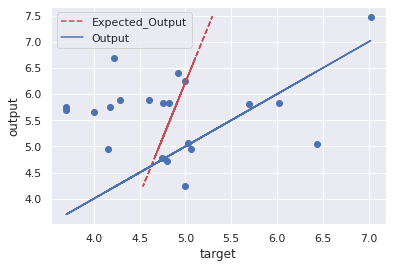

In [238]:
import numpy as np
import sklearn.neural_network
import pandas
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

model=sklearn.neural_network.MLPRegressor(
    activation='relu',
    learning_rate_init=0.001,
    solver='sgd',
    learning_rate='invscaling',
    hidden_layer_sizes=(200,),
    verbose=True,
    max_iter=2000,
    tol=1e-6
)

x=model.fit(X_train,y_train)
print('Accuracy training : {:.3f}'.format(model.score(X_train,y_train)))
print('\nprediction:')
predicted_scale=model.predict(X_test)
print(predicted_scale)
print("RMSE", mean_squared_error(y_test,predicted_scale))
p1=np.polyfit(predicted_scale,y_test,1)
plt.plot(np.polyval(p1,predicted_scale),predicted_scale,'r--',label='Expected_Output')
plt.xlabel('target')
plt.ylabel('output')
#plt.ylim((0,1))
plt.scatter(y_test,predicted_scale)
plt.plot(y_test,y_test,label='Output')
plt.legend(loc='upper left')
plt.show()

In [196]:
#########
from sklearn.model_selection import KFold
folds = KFold(n_splits = 6, shuffle = True, random_state = 100)
scores = cross_val_score(model, X_train, y_train, cv=folds)
scores 

array([-0.1006698 , -0.38884586,  0.36152434,  0.58238222,  0.61174398,
        0.64270655])

# Ridge CV linear model

In [197]:
from sklearn import linear_model

reg = linear_model.RidgeCV(alphas=np.logspace(-6, 6, 13))
reg.fit(X_train,y_train)
y_pred = reg.predict(X_test)
r2_ridge = r2_score(y_test, y_pred)
mse_ridge = mean_squared_error(y_test, y_pred)
mae_ridge = mean_absolute_error(y_test, y_pred)
print("r2_score: ", r2_ridge)
print("MSE: ", mse_ridge)
print("MAE: ", mae_ridge)

r2_score:  0.3846959792056813
MSE:  0.4259363656899295
MAE:  0.5076157776691645


#Bayesian Ridge model

In [182]:
reg = linear_model.BayesianRidge()
reg.fit(X_train,y_train)
y_pred = reg.predict(X_test)
r2_score(y_test, y_pred)
r2_bayessian = r2_score(y_test, y_pred)
mse_bayessian = mean_squared_error(y_test, y_pred)
mae_bayessian = mean_absolute_error(y_test, y_pred)
print("r2_score: ", r2_bayessian)
print("MSE: ", mse_bayessian)
print("MAE: ", mae_bayessian)

r2_score:  0.4698237027227068
MSE:  0.3670077841287511
MAE:  0.46945693025205104


R-squared values should be between 0.5 and 0.6 for most workable models.  So this model is valid and usable.

Scatterplot of Predicted vs Experimental pIC50

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<function matplotlib.pyplot.show>

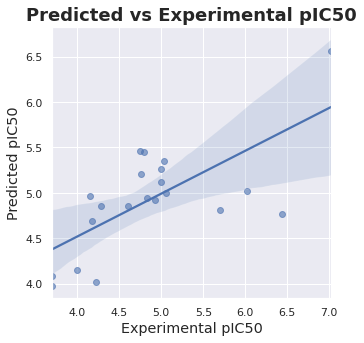

In [183]:
ax = sns.regplot(y_test, y_pred, scatter_kws = {'alpha':0.6})
ax.set_xlabel('Experimental pIC50', fontsize = 'large')
ax.set_ylabel('Predicted pIC50', fontsize='large')
plt.title('Predicted vs Experimental pIC50', size = 18, fontweight = 'bold')
ax.figure.set_size_inches(5, 5)
plt.show

In [184]:
import plotly.express as px

fig = px.scatter(y_test, y_pred, color = "pIC50")

fig.update_layout(
    height=600,
    width=600,
    title_text='Predicted vs Experimental pIC50')

fig.show()

A good molecule to investigate would have a pIC50 of near 5.5 or greater.  This would give a stronger inhibition of the binded protein on SARs virus.

This is the end.  As you can see we can predict molecules with a pIC50 greater than 5.5, although a better goal to strive for is 6.  Our model is valid with a r-squared value greater than 0.5 as well.

In [185]:
from sklearn.svm import SVR
clf = SVR(C = 10.0, epsilon = 1.0)
clf.fit(X_train,y_train)
y_pred_clf = clf.predict(X_test)
r2_svr1 = r2_score(y_test, y_pred_clf)
mse_svr1 = mean_squared_error(y_test, y_pred_clf)
mae_svr1 = mean_absolute_error(y_test, y_pred_clf)
print("r2_score: ", r2_svr1)
print("MSE: ", mse_svr1)
print("MAE: ", mae_svr1)

r2_score:  0.4246564417795815
MSE:  0.39827424481179363
MAE:  0.549180865862826


In [ ]:
from sklearn.svm import SVR
clf = SVR(C = 20.0, epsilon = 1.0)
clf.fit(X_train,y_train)
y_pred_clf = clf.predict(X_test)
r2_svr2 = r2_score(y_test, y_pred_clf)
mse_svr2 = mean_squared_error(y_test, y_pred_clf)
mae_svr2 = mean_absolute_error(y_test, y_pred_clf)
print("r2_score: ", r2_svr2)
print("MSE: ", mse_svr2)
print("MAE: ", mae_svr2)

In [ ]:
from sklearn.svm import SVR
clf = SVR(C = 50.0, epsilon = 0.5)
clf.fit(X_train,y_train)
y_pred_clf = clf.predict(X_test)
r2_svr3 = r2_score(y_test, y_pred_clf)
mse_svr3 = mean_squared_error(y_test, y_pred_clf)
mae_svr3 = mean_absolute_error(y_test, y_pred_clf)
print("r2_score: ", r2_svr3)
print("MSE: ", mse_svr3)
print("MAE: ", mae_svr3)

In [ ]:
from sklearn.svm import SVR
clf = SVR(C = 50.0, epsilon = 1.0)
clf.fit(X_train,y_train)
y_pred_clf = clf.predict(X_test)
r2_svr4 = r2_score(y_test, y_pred_clf)
mse_svr4 = mean_squared_error(y_test, y_pred_clf)
mae_svr4= mean_absolute_error(y_test, y_pred_clf)
print("r2_score: ", r2_svr4)
print("MSE: ", mse_svr4)
print("MAE: ", mae_svr4)

In [ ]:
from sklearn.svm import SVR
clf = SVR(C = 100.0, epsilon = 1.0)
clf.fit(X_train,y_train)
y_pred_clf = clf.predict(X_test)
r2_svr5 = r2_score(y_test, y_pred_clf)
mse_svr5 = mean_squared_error(y_test, y_pred_clf)
mae_svr5 = mean_absolute_error(y_test, y_pred_clf)
print("r2_score: ", r2_svr5)
print("MSE: ", mse_svr5)
print("MAE: ", mae_svr5)

In [ ]:
from sklearn.svm import SVR
clf = SVR(C = 100.0, epsilon = 1.5)
clf.fit(X_train,y_train)
y_pred_clf = clf.predict(X_test)
r2_svr6 = r2_score(y_test, y_pred_clf)
mse_svr6 = mean_squared_error(y_test, y_pred_clf)
mae_svr6 = mean_absolute_error(y_test, y_pred_clf)
print("r2_score: ", r2_svr6)
print("MSE: ", mse_svr6)
print("MAE: ", mae_svr6)

In [ ]:
from sklearn.svm import SVR
clf = SVR(C = 120.0, epsilon = 1.5)
clf.fit(X_train,y_train)
y_pred_clf = clf.predict(X_test)
r2_svr7 = r2_score(y_test, y_pred_clf)
mse_svr7 = mean_squared_error(y_test, y_pred_clf)
mae_svr7 = mean_absolute_error(y_test, y_pred_clf)
print("r2_score: ", r2_svr7)
print("MSE: ", mse_svr7)
print("MAE: ", mae_svr7)

In [186]:
randomforest = ["Random Forest Regression model", R_square, mse_rnf, mae_rnf]
ridge = ["Ridge CV model", r2_ridge, mse_ridge, mae_ridge]
bayessian = ["Bayessian Ridge model", r2_bayessian, mse_bayessian, mae_bayessian]
svr1 = ["SVR model", r2_svr1, mse_svr1, mae_svr1]
data = [randomforest, ridge, bayessian, svr1]
df1 = pd.DataFrame(data, columns = ['Model', 'r2 score', 'MSE', 'MAE'])
df1

,Model,r2 score,MSE,MAE
0,Random Forest Regression model,0.423855,0.419077,0.467801
1,Ridge CV model,0.384696,0.425936,0.507616
2,Bayessian Ridge model,0.469824,0.367008,0.469457
3,SVR model,0.424656,0.398274,0.549181
